# Setup

reference: https://github.com/tylin/coco-caption/blob/master/cocoEvalCapDemo.ipynb

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/results/coco-caption

%matplotlib inline
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap
import matplotlib.pyplot as plt
import skimage.io as io
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

import json
from json import encoder
encoder.FLOAT_REPR = lambda o: format(o, '.3f')

/content/drive/MyDrive/results/coco-caption


# Load dataset

In [ ]:
%cd /content/drive/MyDrive/results
import pickle
import nltk
nltk.download('punkt')

with open('./imageCaptions/lstm_results2.pkl', 'rb') as f:
  lstm_results = pickle.load(f)

/content/drive/MyDrive/results
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
with open('./imageCaptions/lstm_result_ids2.pkl', 'rb') as f:
  lstm_result_ids2 = pickle.load(f)

In [ ]:
# Read adjective list
filename = 'anp_list.txt'

with open(filename, 'r') as f:
    lines = f.readlines()

anp = []

for i in range(0,len(lines)):
    anp.append(lines[i].rsplit(' ',1)[0])
  
anps = list(set(anp))

# Create generated sentence without adjectives

In [ ]:
# Setence without adjectives
senTocompare = []

for i in range(0,len(lstm_results)):
  tokens = nltk.tokenize.word_tokenize(lstm_results[i].lower())
  tokensNotadjs = [t for t in tokens if t not in anps]
  withoutAdjs = " ".join(tokensNotadjs)
  senTocompare.append(withoutAdjs)

In [ ]:
# Load original captions
import json

with open('./captions_val2014.json') as json_file:
    captions_val2014 = json.load(json_file)

In [ ]:
# Find image ids
image_ids = [] 

for i in range(0,len(lstm_result_ids2)):
  for j in range(0,len(captions_val2014['images'])):
    if lstm_result_ids2[i] == captions_val2014['images'][j]['file_name']:
      image_ids.append(captions_val2014['images'][j]['id'])

In [ ]:
# Create Json file for generated sentences
import collections
sendict = []

for i in range(0,len(image_ids)):
  dict_temp = {'image_id': image_ids[i],
               'caption': lstm_results[i]}
  od = collections.OrderedDict(sorted(dict_temp.items(), reverse=True))
  sendict.append(od)

In [ ]:
with open('lstm_generated_sen.json', 'w') as outfile:
  json.dump(sendict, outfile)

In [ ]:
os.getcwd()

'/content/drive/My Drive/results'

# Load created dataset

In [ ]:
# set up file names and pathes
# Data Directory
groud_truth = './coco-caption/annotations/captions_val2014.json'
generated_sen = './lstm_generated_sen.json'

## I don't know whether this stanford model is needed
# download Stanford models
%cd /content/drive/MyDrive/results/coco-caption
!./get_stanford_models.sh

/content/drive/MyDrive/results/coco-caption
/bin/bash: ./get_stanford_models.sh: /usr/bin/env: bad interpreter: Permission denied


In [ ]:
## COCO reads original COCO style file: captions_val2014.json 
## loadRes reads load Id and caption json file
## Example: {"image_id": 404464, "caption": "black and white photo of a man standing in front of a building"}

%cd /content/drive/MyDrive/results
ground_truth = COCO(groud_truth)
gen_sen = ground_truth.loadRes(generated_sen)

/content/drive/MyDrive/results
loading annotations into memory...
0:00:01.400318
creating index...
index created!
Loading and preparing results...     
DONE (t=0.24s)
creating index...
index created!


# Calculate evaluation metrics

In [ ]:
%cd /content/drive/MyDrive/results/coco-caption

/content/drive/MyDrive/results/coco-caption


In [ ]:
# create cocoEval object by taking coco and cocoRes
#cocoEval = COCOEvalCap(coco, cocoRes)
cocoEval = COCOEvalCap(ground_truth, gen_sen)

# evaluate on a subset of images by setting
# cocoEval.params['image_id'] = cocoRes.getImgIds()
# please remove this line when evaluating the full validation set
#cocoEval.params['image_id'] = cocoRes.getImgIds()
cocoEval.params['image_id'] = gen_sen.getImgIds()

# evaluate results
# SPICE will take a few minutes the first time, but speeds up due to caching
cocoEval.evaluate()

tokenization...
setting up scorers...
computing Bleu score...
{'reflen': 870, 'guess': [750, 650, 550, 450], 'testlen': 750, 'correct': [299, 55, 13, 2]}
ratio: 0.862068965516
Bleu_1: 0.340
Bleu_2: 0.157
Bleu_3: 0.079
Bleu_4: 0.037
computing METEOR score...
METEOR: 0.117
computing Rouge score...
ROUGE_L: 0.244
computing CIDEr score...
CIDEr: 0.284
computing SPICE score...
SPICE: 0.078


In [ ]:
# print output evaluation scores
for metric, score in cocoEval.eval.items():
    print '%s: %.4f'%(metric, score)

CIDEr: 0.2837
Bleu_4: 0.0370
Bleu_3: 0.0790
Bleu_2: 0.1565
Bleu_1: 0.3397
ROUGE_L: 0.2443
METEOR: 0.1173
SPICE: 0.0778


# Bad result

length: 39
314370
ground truth captions
A kitchen filled with clutter all over it's counter.
 A kitchen is cluttered with cooking supplies, especially eggs
a kitchen with a stove and counter tops and shelves filled with food.
A large variety of food spread out on a counter.
A kitchen counter is stacked up with food from the store.


generated caption (CIDEr score 0.0)
the wall was by the refrigerator


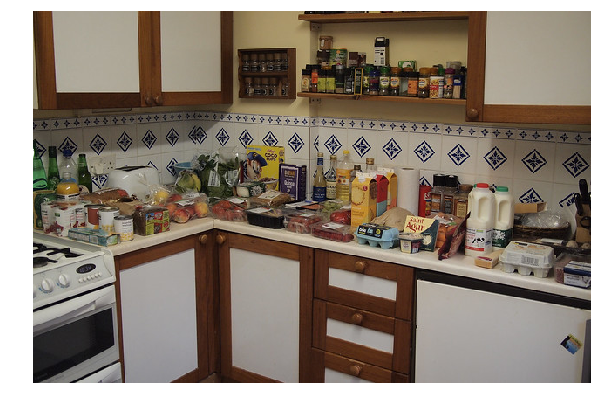

71738
ground truth captions
A man holding a motorcycle helmet is moving a chair in a public place.
A man holds a motorcycle helmet in a park.
A man carrying a chair and a helmet.
A man holding a helmet and carrying a chair.
A man with a fro kickin over a metal chair.


generated caption (CIDEr score 0.0)
two people standing together with large teddy


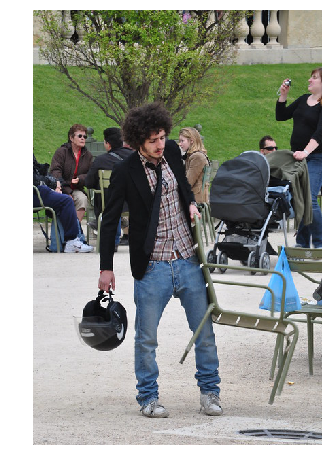

519764
ground truth captions
Cat lethargically on comfy computer chair looking relaxed.
A cat sitting on top of a black leather chair.
a cat sitting in an office chair. 
A cat that is laying down on a chair.
The sat is sitting in the computer chair. 


generated caption (CIDEr score 0.0)
an image of room with two zebra bed


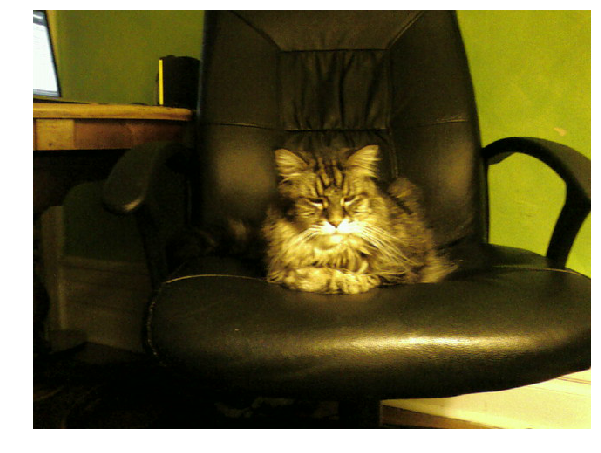

62549
ground truth captions
A guy in funny hat holding a very big bird.
A man that is holding a falcon in his hand.
A man is holding a pigeon in one of his hands. 
A man holding a large bird on his left hand.
The man has a very big bird on his arm.


generated caption (CIDEr score 0.0)
three people standing at an rock umbrella
153392
ground truth captions
Many of the kites ascend high into the clouds.
A group of kites flying in the blue sky on a nice day. 
a blue sky that has a kite in it
a couple of kites are flying in the sky

Two views of bright objects floating through the blue sky.


generated caption (CIDEr score 0.0)
view of river there where the water that are in the water
20069
ground truth captions
A child that is playing on a toy out in the park.
A child is playing in a recreational park.
A child playing on a moving playground set.
A child is playing on a yellow gym park set. 
a small kid plays in a park 


generated caption (CIDEr score 0.0)
man is his skateboard trick on t

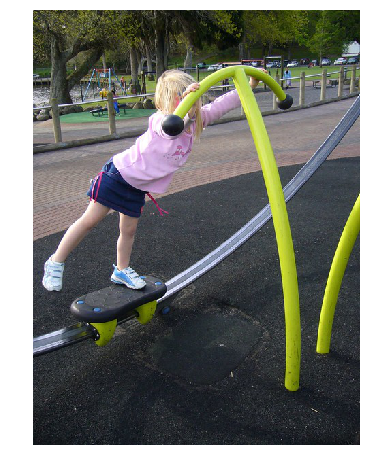

375915
ground truth captions
Pizza on a tray on the table outside next to plates and wine glass
A table outside with a pizza on it with several toppings. 
Pizza type meal set out on a wooden table with plates.
A pizza sitting on an outdoor table in the sun
A table that has pizza, wine, a candle, plates, and another food dish on it. 


generated caption (CIDEr score 0.0)
boy with eyes is going to


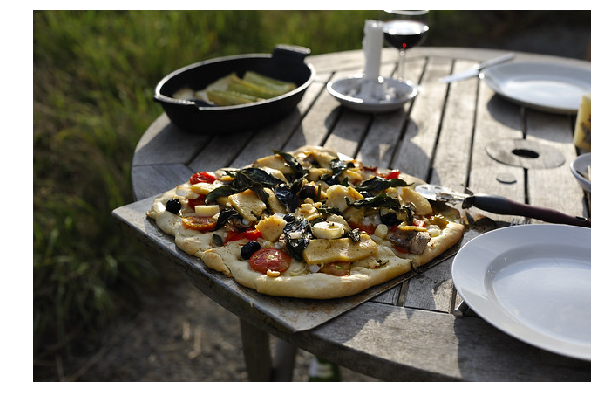

71281
ground truth captions
some black and white sheep a fence dirt and grass
Sheep that have been sheared standing in a pen.
Several grey sheep on a dry grassy field.
a goat in a fied hangs out with other goats
The animals look very skinny and unhealthy as they walk around.


generated caption (CIDEr score 0.0)
two cows stand near each other in the field


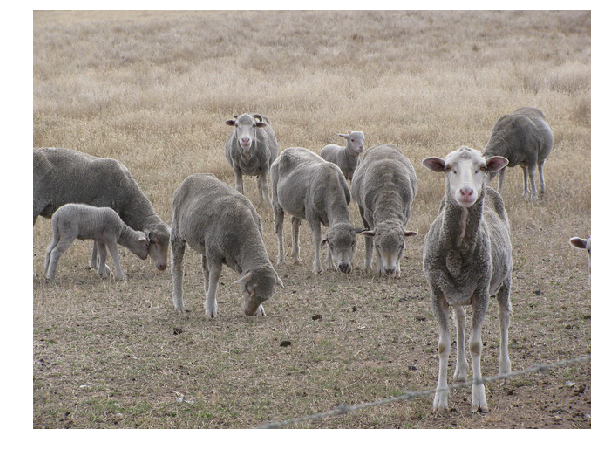

77954
ground truth captions
A man plays with a Frisbee while a crowd looks on. 
A man holding a neon yellow frisbee in his right hand.
This man is in the middle of an ultimate Frisbees competition 
A man that is getting ready to throw a frisbee.
A man winding up with a frisbee on a court.


generated caption (CIDEr score 0.0)
the girl bright makes lady to play tennis


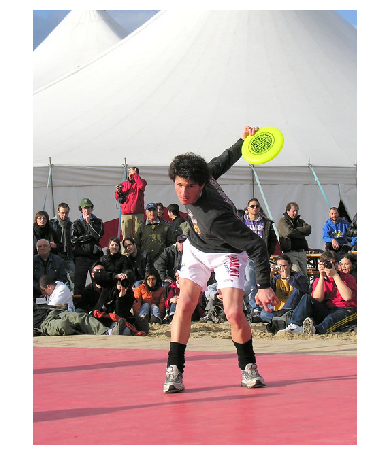

82052
ground truth captions
A man riding a skateboard down the middle of a street.
A person rides on a skateboard down the street.
Bottom half of a person on a skateboard with sky in background. 
A man on a skateboard riding in the street. 
A man's legs standing on a skateboard on a road


generated caption (CIDEr score 0.0)
man frisbee in of grass


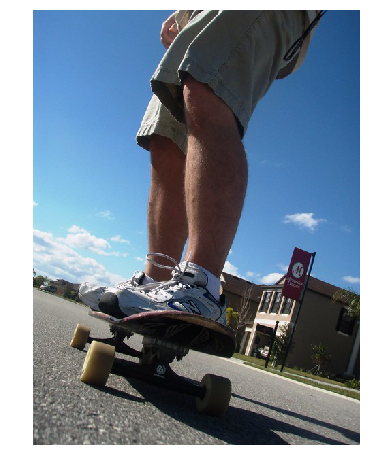

115846
ground truth captions
A small glass filled with alcohol sitting on a table.
A half-filled drinking glass on a table near books and a television remote control.
A table with a glass that is half full, books and a magazine stacked together and remote control.
A table-top with books, a remote and beverage-filled glass.
A glass of liquid sits next to books and a remote.


generated caption (CIDEr score 0.0)
the computer doesnt are on the sofa by the table


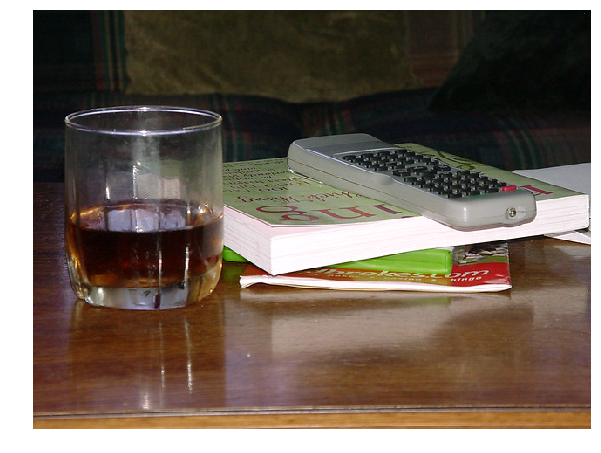

25758
ground truth captions
A lady holding a pan with a big turkey in an open oven.
A woman is taking the cooked turkey out of the oven
Woman pulling large roaster with roast chicken in it
A woman is taking a turkey out of the oven.
Woman removing a roast turkey and stuffing from a home oven,


generated caption (CIDEr score 0.0)
the wall was by the refrigerator


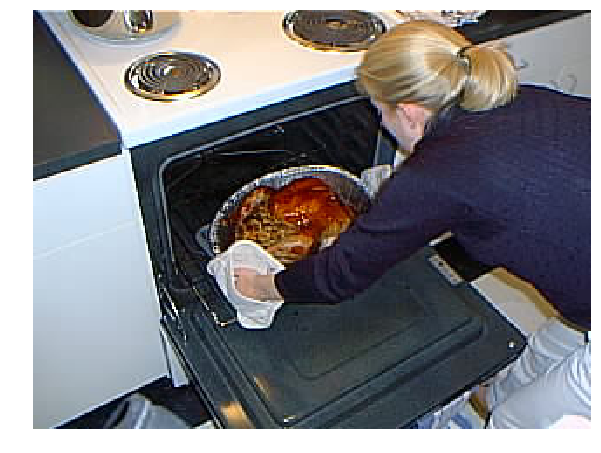

98493
ground truth captions
Cars parked and driving in front of a school.
A clock on the outside of a building with vehicles parked. 
A white and black clock on the front of a building
Several cars parked in front of building with a clock on it.
Several cars are parked in front of the building.


generated caption (CIDEr score 0.0)
really view of large red and car red street


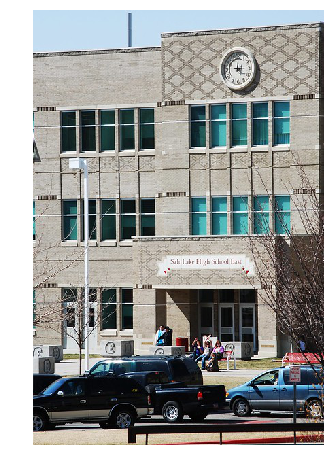

204507
ground truth captions
THERE ARE TWO PEOPLE THAT ARE STANDING TOGETHER 
A couple of men hanging out sitting outside
Two men sitting together point at something in the distance. 
Two men at a cafe looking at something.
Two men standing next to each other outside


generated caption (CIDEr score 0.0)
the man is wearing hat by the street


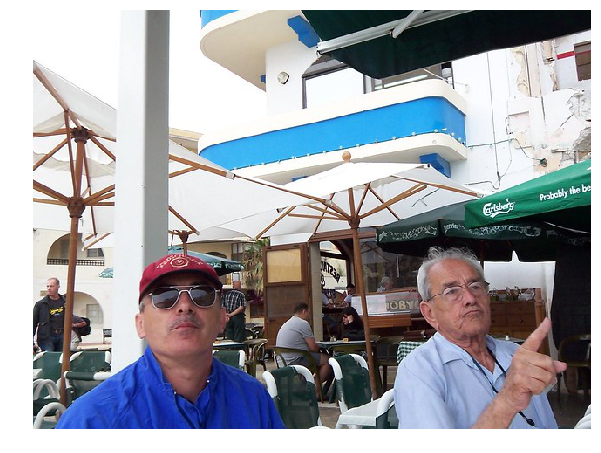

526044
ground truth captions
cow at the waters edge wading in the water
A BROWN AND WHITE COW STANDING NEAR THE WATER.
A cow walks at the edge of the water.
A cow is standing at the edge of the ocean.
a cow walking on a beach near water


generated caption (CIDEr score 0.0)
the man is wearing hat


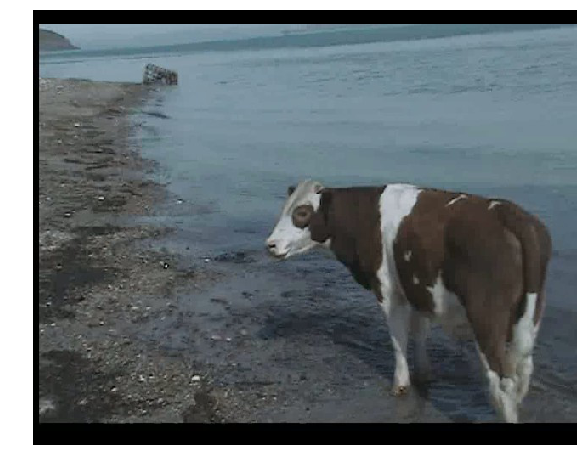

547041
ground truth captions
Two plastic containers have a soup and a salad in them.
Two containers, one with a salad, and another with some sort of other food in it.
Two containers with two different salads containing lettuce.
The salad is ready to eat for lunch. 
A tray of salad and a tray of salad toppings to the side.


generated caption (CIDEr score 0.0)
the food was used look at all


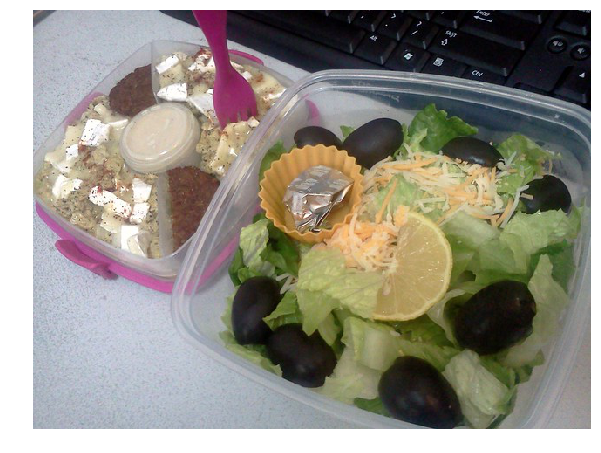

493805
ground truth captions
Two giraffes in a zoo look at their surroundings
Two giraffes are standing at a wild animal park. 
Two giraffes standing close together near a pile of rocks.
Two giraffes on grassy field with rocks and trees around.
Two giraffes standing together in an outdoor park.


generated caption (CIDEr score 0.0)
giraffe standing next to wall


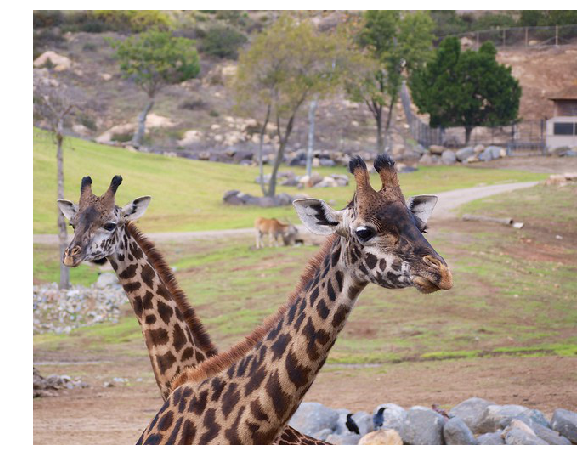

470256
ground truth captions
A kitchen area with sink, dishwasher and refrigerator.
This is a picture of a kitchen with a fridge, sink, and dishwasher.
A washing machine is sitting next to a dishwasher in a kitchen.
A small kitchen has teal green walls and a small window.
an empty kitchen that also has a dishwasher and washing machine


generated caption (CIDEr score 0.0)
the is on the plate of wall


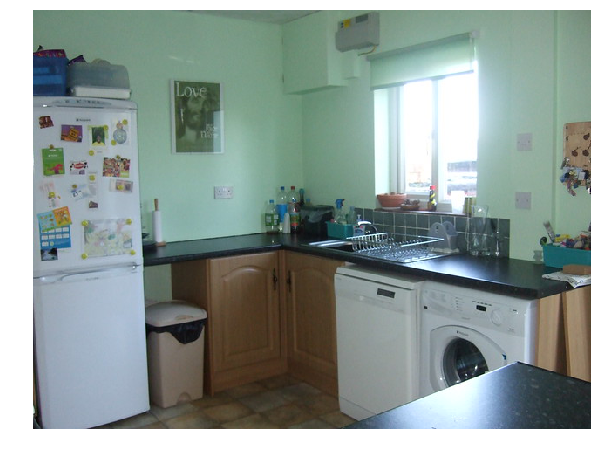

160531
ground truth captions
A man playing Wii bowling in a living room.
Man standing holding a remote control towards a component.
A man pointing a Wii remote at his console. 
A man playing wii bowling in front of the television
A young man pointing a remote at the tv.


generated caption (CIDEr score 0.0)
people play video games with


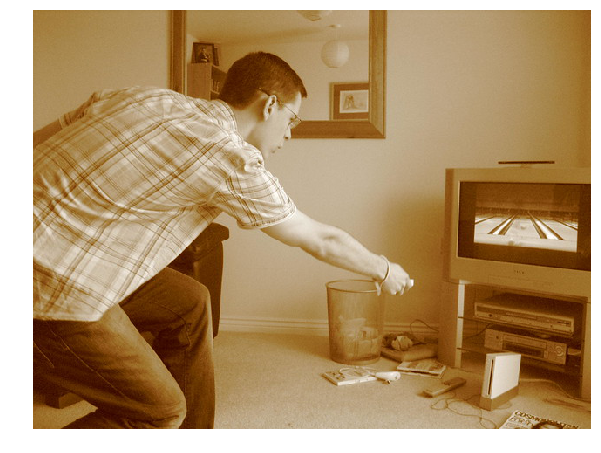

131361
ground truth captions
A man sitting at a table eating donuts.
A man holding a plate with a donut and other food item on it.
A man in sunglasses and jacket holding a plate of food.
Man in sunglasses and leather jacket with a plate of donuts.
A man with sunglasses is holding a plate of donuts.


generated caption (CIDEr score 0.0)
the has one of fruit
246064
ground truth captions
A man with three cows on road next to trees.
A man holding a stick walks with three cows down a street.
A man runs with his 3 cattle along a street
A herder in white walking on a road with his cattle.
A man walking besides cows down a road. 


generated caption (CIDEr score 0.0)
the child was was the baby he is the


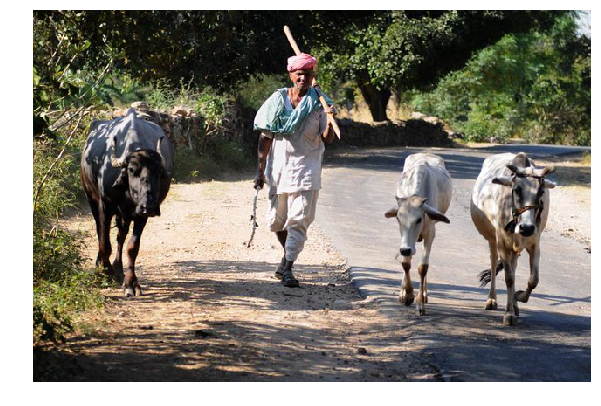

83766
ground truth captions
Several bags are grouped together in a waiting area.
a crowd of people sitting and standing around a bunch of bags.
Allot of colorful luggage and people waiting to leave. 
the people are sitting and standing with lots of luggage
a number of luggage bags piled on one another 


generated caption (CIDEr score 0.0)
man is looking at the camera as he is as man


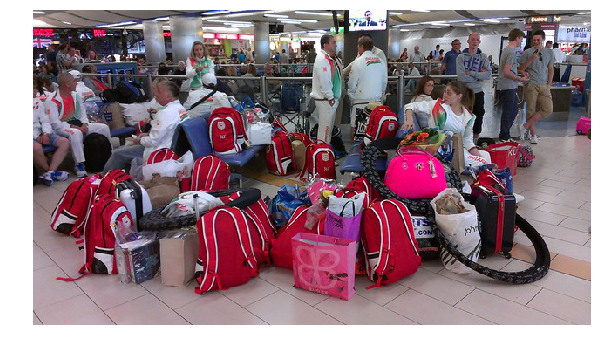

368459
ground truth captions
Two people riding a ski lift with snowboards on their feet. 
Two people are sitting in a chair lift with their feet on a snow board and skis dangling 
a couple sitting on a bench and headed up a snow mountain
Two people sit on a ski lift with snowboards.
Two snowboarders ride the ski lift to the top of the mountain. 


generated caption (CIDEr score 0.0)
man holding skis standing on snow covered mountains


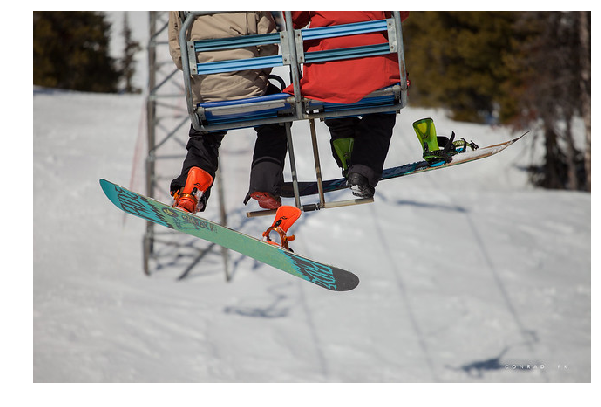

345941
ground truth captions
A desert on a plate with a spoon on the side of the plate.
A plate with strawberries and ice cream on a cake.
A dessert topped with ice cream, and strawberries sits on a plate.
A white dish that has an ice cream and cookie style dessert on it, along with powdered sugar sprinkled over it.
A plate with an ice cream dessert on it 


generated caption (CIDEr score 0.0)
people play the of the bathroom
509270
ground truth captions
There are two kites flying in the wind.
A large kite made of magazine pages in the air.
Two kites are flying in a blue sky. 
A patterned kite silhouetted against a clear blue sky.
Yellow kite flying over top of a very large kinds in the sky. 


generated caption (CIDEr score 0.0)
an image of person carrying umbrella


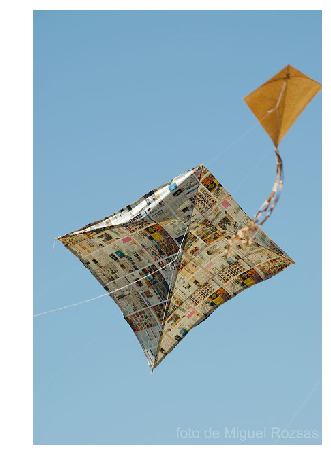

33638
ground truth captions
A woman observing something on a kitchen stove.
A woman is cooking on a large black stove
A woman cooking on an old fashioned stove.
A man preparing food on a large old oven.
A woman wearing shorts bends over a frying pan on a stove.


generated caption (CIDEr score 0.0)
the wall was by the refrigerator


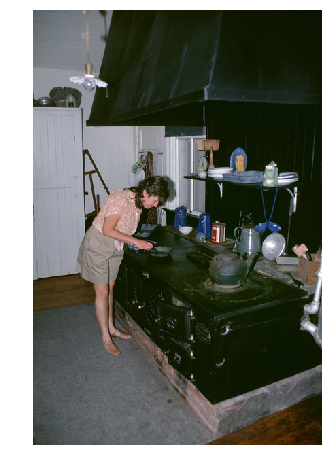

479597
ground truth captions
A man wearing a white shirt and red tie.
A man in white shirt and tie in room.
The man in the tie is ready for an important event.
A man in a red tie stands with his hands in his pockets.
A man in a white business shirt wearing a red tie. 


generated caption (CIDEr score 0.0)
man sitting on the table with bottle


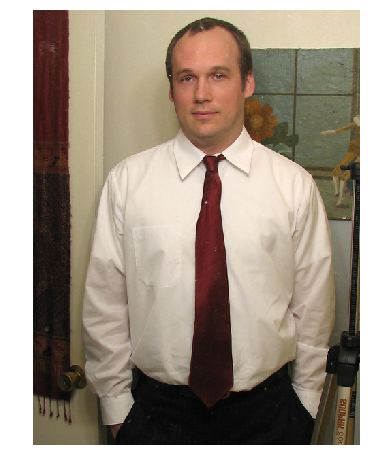

36238
ground truth captions
A pot full of beef and broccoli stew. 
A broccoli and beef dish with baby corn.
A pot of food contains meats and vegetables
Soup with broccoli  and meat cooking on a stove.
Broccoli and meat in a large pot that is ready for serving. 


generated caption (CIDEr score 0.0)
an boat is out by the water


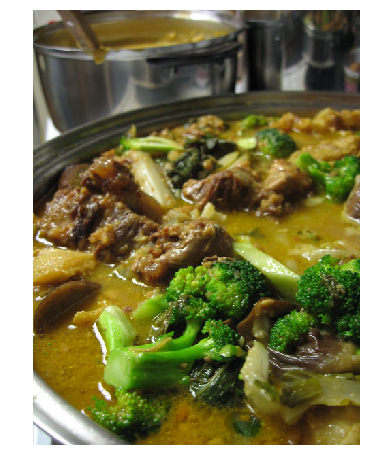

510864
ground truth captions
A person in a wet suit is surfing 
A woman riding a surfboard on top of rapid water.
A woman on a surfboard is riding a wave
a man that is on a surfboard on some water
a woman on a surfboard riding a wave


generated caption (CIDEr score 0.0)
man paddle on lake


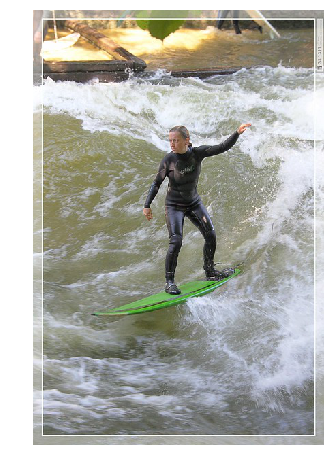

423830
ground truth captions
A bird walking through some gravel as its baby chicks follow.
a small bird in a field with gravel and grass
A bird standing in a grassy and rocky area.
Ducks are walking along the grass and rocks.
Small birds walking on the grass next to the body of water. 


generated caption (CIDEr score 0.0)
the wall was by the giraffe


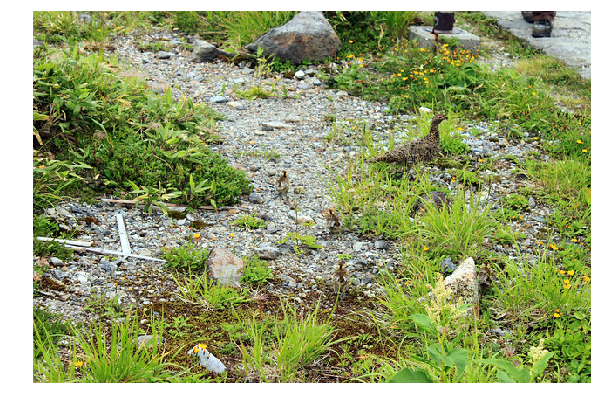

221094
ground truth captions
A man and woman are on a bicycle pulling luggage.
Two young people are riding a bike together next to the parked vehicles. 
a man and woman are riding a bicycle
Two people on a bicycle dragging a suitcase on wheels behind them.
A man riding a motorcycle with a woman on back of it.


generated caption (CIDEr score 0.0)
man is sitting on park bench with his hands


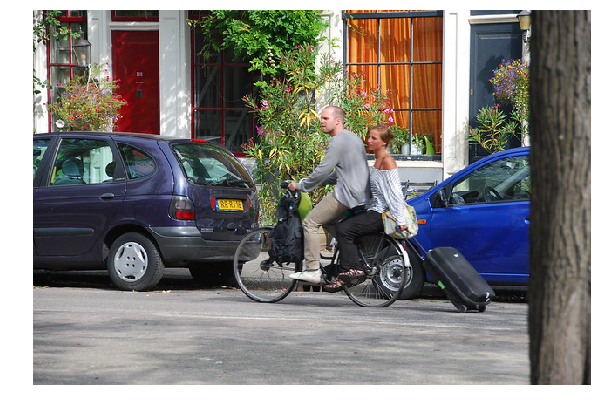

84410
ground truth captions
an odd looking blender with three serving glasses 
The vase is on display in the museum.
A drink maker sitting on a silver counter.
A blender on display next to some small glasses.
A blender sitting next to a  counter near a plaque.


generated caption (CIDEr score 0.0)
an cat sitting on top of desk
525777
ground truth captions
A picture of a man sitting in a train.
An elderly passenger seated inside a colorful train car.
The back of a man's head is shown on the bus.
A man in a suit sits alone on a bus.
A man is sitting down on the inside of the train.  


generated caption (CIDEr score 0.0)
these people are going to wait for long


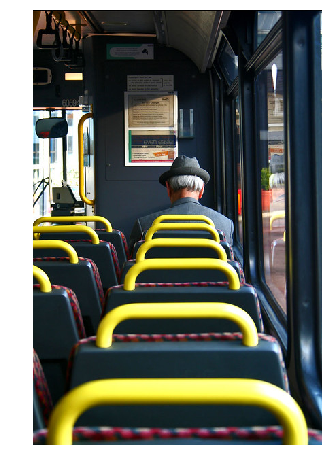

355297
ground truth captions
A surfer in the middle of a jump in the ocean
A man in the air while surfing in a water suit. 
A man riding a board into the air over foamy water.
A man in a black wetsuit is surfing in the water. 
A person on a surfboard in mid-air with water splashing under him.


generated caption (CIDEr score 0.0)
boy with his rides going to car


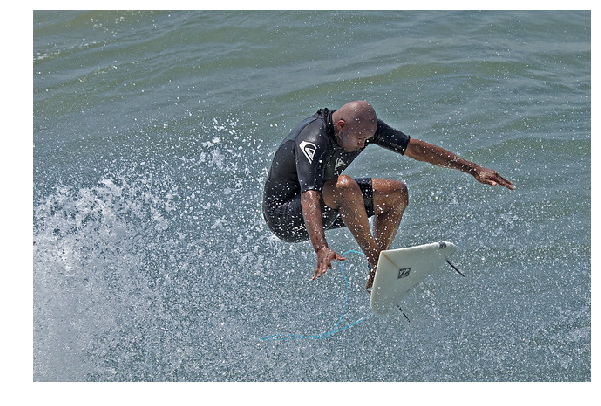

118260
ground truth captions
A couple of people walking across a lush green field.
People are in the grass flying a kite.
Two people in open field watching yellow tent blown away. 
People standing at a park with a large yellow kite.
Three people on an open field with a banner 


generated caption (CIDEr score 0.0)
the dog is being dog


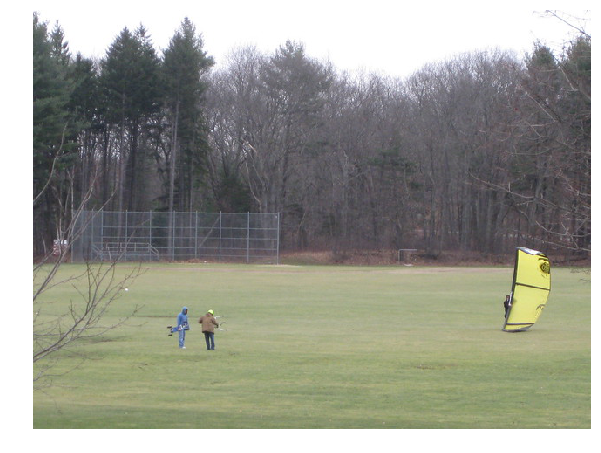

144373
ground truth captions
A person with a blue ring eating a doughnut
Two hands holding a half eaten jelly filled donut.
childs hands holding powdered sugar donut with chocolate inside
a close up of a person holding a jelly filled doughnut
A person eating a very large donut with two hands.


generated caption (CIDEr score 0.0)
the pizza has on the plate
516602
ground truth captions
A small calf is in a pen with bails of hay.
A truck with an animal, hay, and other containers in the back.
An old metal box with rolls of twine
A cow in the back of a large truck.
A truck with some random things in the back


generated caption (CIDEr score 0.0)
an cat sitting on the ground of water


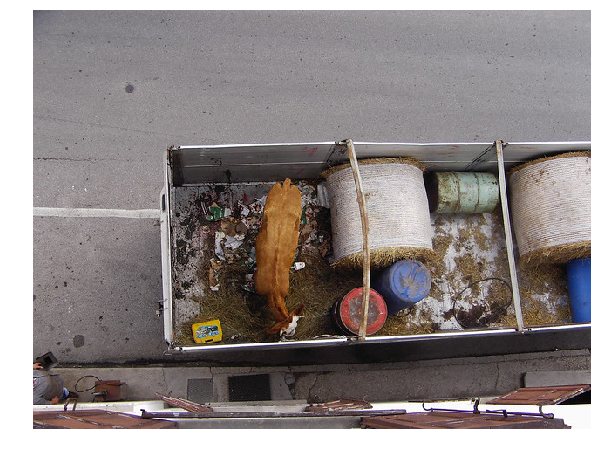

175611
ground truth captions
A person with a pair of scissors cutting into a cigar.
A wood working trimming the wood with pair of scissors.
An old hand is cutting cigars with scissors.
A pair of hands with scissors cutting a cigar.
Hands cutting a piece of paper with wood shavings on a table.


generated caption (CIDEr score 0.0)
the face of building contains clock


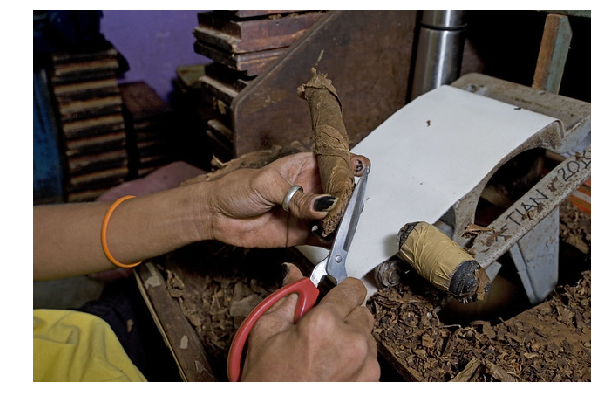

404988
ground truth captions
A line of benches that are snow covered
Several wooden benches, all lined up, lightly covered in snow.
Snow covered benches with bushes in the background
The benches along the sidewalk are covered with snow.
A line of outdoor benches are covered in snow. 


generated caption (CIDEr score 0.0)
the man is wearing hat in the tree


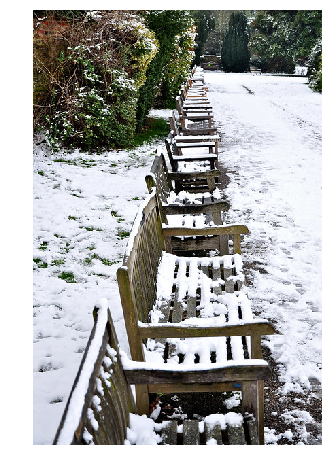

In [ ]:
# Bad result of LSTM
evals = [eva for eva in cocoEval.evalImgs if eva['CIDEr']<0.1]
print 'length:', len(evals)

for i in range(0,len(evals)):
  imgId = evals[i]['image_id']
  print imgId
  print 'ground truth captions'
  annIds = ground_truth.getAnnIds(imgIds=imgId)
  anns = ground_truth.loadAnns(annIds)
  ground_truth.showAnns(anns)

  print '\n'
  print 'generated caption (CIDEr score %0.1f)'%(evals[0]['CIDEr'])
  annIds = gen_sen.getAnnIds(imgIds=imgId)
  anns = gen_sen.loadAnns(annIds)
  ground_truth.showAnns(anns)

  img = ground_truth.loadImgs(imgId)[0]
  try:
    I = io.imread(img['url'])
  except:
    continue
  plt.imshow(I)
  plt.axis('off')
  plt.show()

# Good result

length: 14
172556
ground truth captions
An instructor teaching people how to surf on the beach
Four people learning how to surf on a sandy beach
A group of people pretend to surf on the beach next to hotels.
A group of young people standing on a beach next to a surfboard.
people standing on a beach being taught how to surf


generated caption (CIDEr score 0.7)
people surf on the water in lake


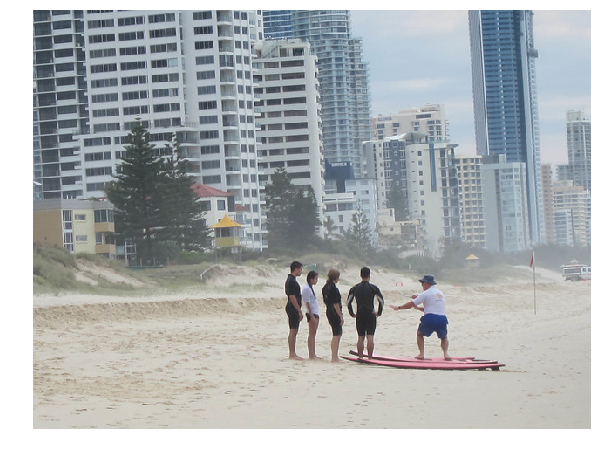

480793
ground truth captions
The walls outside the small bathroom have a blue tint.
A bathroom with toilet, shower, and cabinets in it.
A white toilet sitting next to a shower.
A bathroom has a white counter top and shower curtain.
a bathroom with a sink and a toilet


generated caption (CIDEr score 0.7)
bathroom with toilet bath tub and shower head


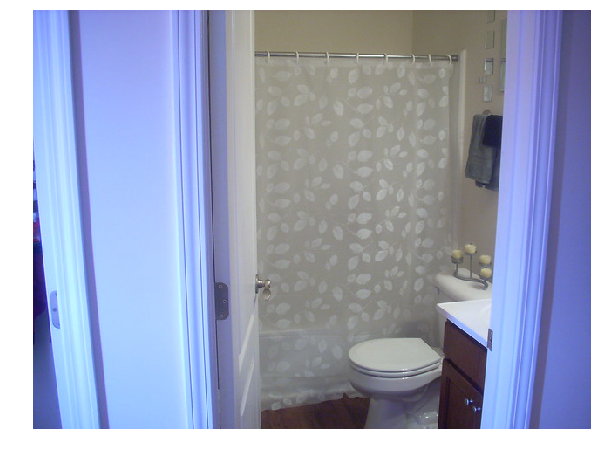

372807
ground truth captions
A zebra standing on top of a grass covered field.
The zebra is looking directly into the camera lense,
A front view of a zebra looking at the camera.
A zebra that is standing in the grass.
A zebra standing in the grass near trees.


generated caption (CIDEr score 0.7)
zebra standing on top of grass


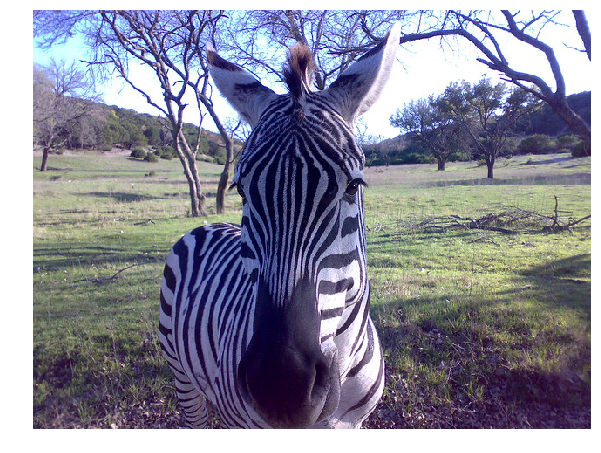

535668
ground truth captions
A baseball player bending over to hit a ball.
A man swinging a bat during a baseball game.
some baseball players are playing baseball on a field
A baseball player swinging a bat at a pitch
a baseball player hitting a baseball at home base


generated caption (CIDEr score 0.7)
two people playing baseball with couple of


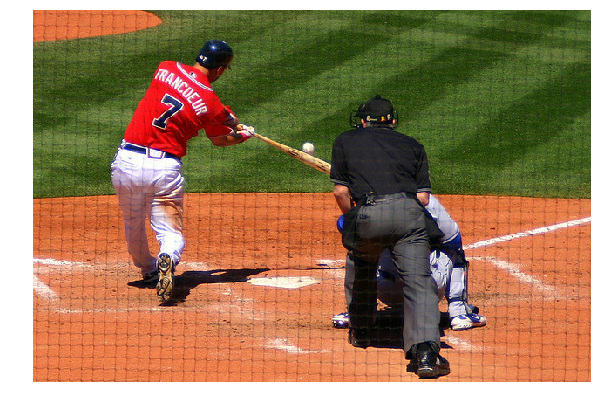

19663
ground truth captions
A woman holding a tennis racquet on a tennis court.
The woman is hitting tennis balls with a tennis racket.
A tennis player in blue swings back racket with one hand to return a shot.
a lady practicing hitting tennis balls with a machine
A tennis player swinging a racket at a tennis ball.


generated caption (CIDEr score 0.7)
the woman is playing tennis on the court


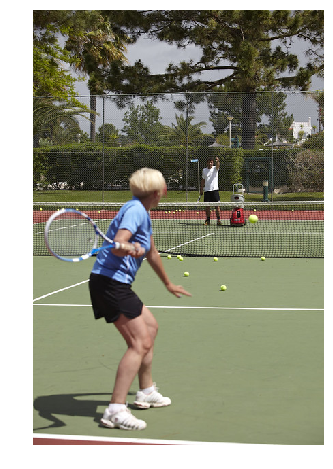

28110
ground truth captions
A giraffe walking through the forest in the wild. 
A giraffe is walking in the open grass land
There is a giraffe walking through some trees
A giraffe walks on the grass through some trees. 
A giraffe grazing a field with trees on a hill.


generated caption (CIDEr score 0.7)
giraffe standing next to wall


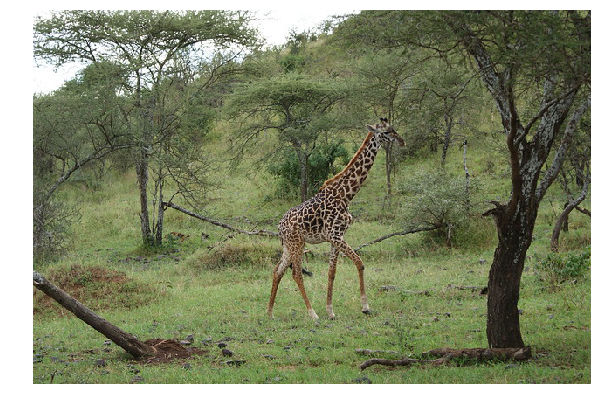

535307
ground truth captions
A sandy beach next to the ocean under a sky filled with kites.
The people on the beach are flying their kites. 
Kites are flying over a pebbled beach as people gather on the shore.
Several people at the beach flying some kites.
People are on the beach with kites flying.


generated caption (CIDEr score 0.7)
group of people on top of grassy beach


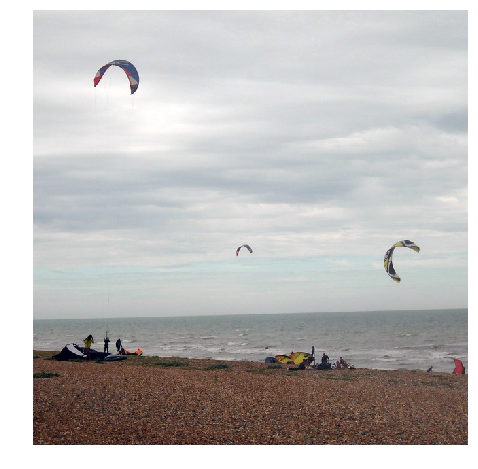

440093
ground truth captions
A man flying through the air while riding a skateboard.
a person jumping a skate board in the air 
Skateboarder and board in mid air at a contoured park.
There is a man jumping in the air on a skateboard.
A man performing a skateboard trick in a skateboard park.


generated caption (CIDEr score 0.7)
man is on his skateboard in the air


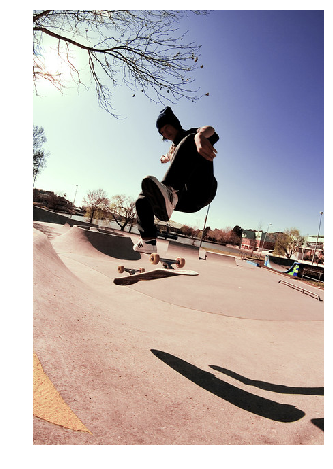

69496
ground truth captions
A plate full of food is ready to be eaten.
A white plate topped with stew and salad.
The meals is done and waiting to be eaten. 
A plate of food consisting of carrots and greens.
a white plate with a variety of meat and vegetables


generated caption (CIDEr score 0.7)
the was on the plate of food


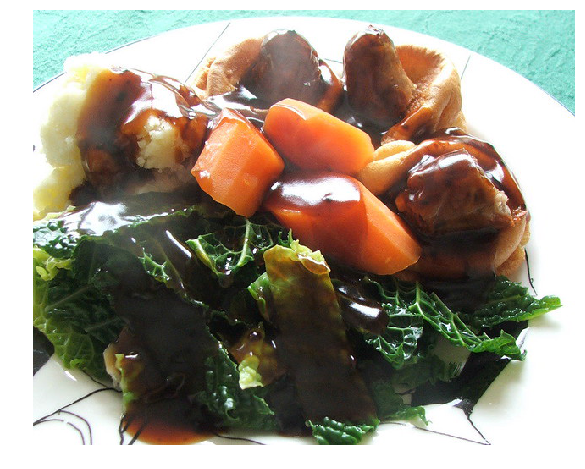

414078
ground truth captions
a dark cat with green eyes is laying on a blue bed
a kitty l with green eyes laying on a blue comforter  
A cat with a serious look on its face sitting on a bed.
A close up of a black and brown cat laying on a bed..
A green eyed cat is on a blue bedspread.


generated caption (CIDEr score 0.7)
the cat is sleeping on the bed
74629
ground truth captions
A man and woman are sitting, being pulled by a horse.
A crowd is watching a man and woman being pulled by a white horse.
A woman taking a ride with a horse on the field.
A white work horse pulling a red wheeled vehicle. 
Two people are in a cart being pulled by a white horse.


generated caption (CIDEr score 0.7)
horse and in the middle of the city


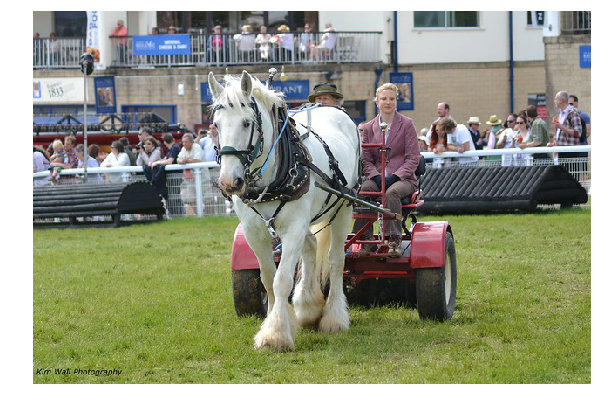

521613
ground truth captions
A living area with chairs, a sofa and a fireplace.
A couch, coffee table, and stand sitting in a living room by a window.
a living room with a lot of chairs and a rug 
A brightly lit and empty modern living room.
A neatly arranged living room with chairs, tables, paintings and a sofa.


generated caption (CIDEr score 0.7)
view of decorated living room dining area to kitchen area


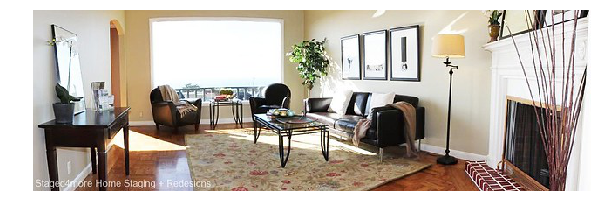

114164
ground truth captions
A herd of zebra walking across a dirt road.
Zebras are crossing a dirt road on the plain.
A herd of five zebras cross the dirt road.
Several zebras cross the road in the desert.
some zebras are walking across a dirt road


generated caption (CIDEr score 0.7)
two zebras stand together on dirt area near grass


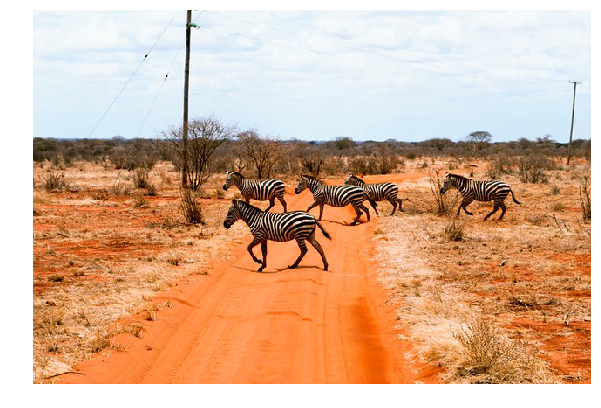

250309
ground truth captions
A woman in a white shirt is playing tennis.
A woman taking a swing at a tennis ball
A girl is running and swinging a tennis racket.
A girl on a tennis court wears black shorts and holds her tennis racket.
A beautiful blond holding a tennis racquet on a  court.


generated caption (CIDEr score 0.7)
the guy is playing tennis player with the tennis match


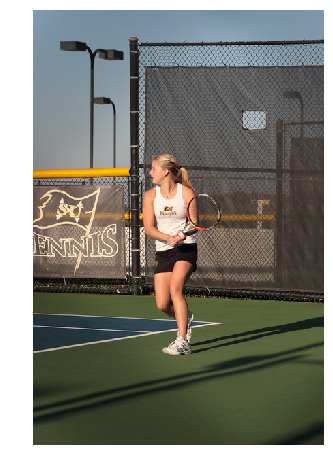

In [ ]:
# Good result of LSTM
evals = [eva for eva in cocoEval.evalImgs if eva['CIDEr']>0.6]
print 'length:', len(evals)

for i in range(0,len(evals)):
  imgId = evals[i]['image_id']
  print imgId
  print 'ground truth captions'
  annIds = ground_truth.getAnnIds(imgIds=imgId)
  anns = ground_truth.loadAnns(annIds)
  ground_truth.showAnns(anns)

  print '\n'
  print 'generated caption (CIDEr score %0.1f)'%(evals[0]['CIDEr'])
  annIds = gen_sen.getAnnIds(imgIds=imgId)
  anns = gen_sen.loadAnns(annIds)
  ground_truth.showAnns(anns)

  img = ground_truth.loadImgs(imgId)[0]
  try:
    I = io.imread(img['url'])
  except:
    continue
  plt.imshow(I)
  plt.axis('off')
  plt.show()


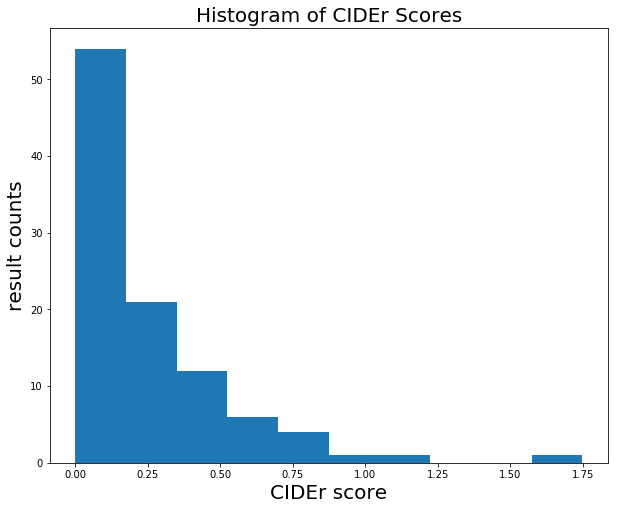

In [ ]:
# plot score histogram
ciderScores = [eva['CIDEr'] for eva in cocoEval.evalImgs]
plt.hist(ciderScores)
plt.title('Histogram of CIDEr Scores', fontsize=20)
plt.xlabel('CIDEr score', fontsize=20)
plt.ylabel('result counts', fontsize=20)
plt.show()

In [ ]:
'''
# save evaluation results to ./results folder
import os
%cd /content/drive/MyDrive/results/evalresults
evalImgsFile = './lstm_imgresults.json'
evalFile = './lstm_evalresults.json'

json.dump(cocoEval.evalImgs, open(evalImgsFile, 'w'))
json.dump(cocoEval.eval,     open(evalFile, 'w'))
'''

/content/drive/MyDrive/results/evalresults
